### Store Sales - Time Series Forecasting
###### [Mission] predicting sales for each product family and store combinations<br>[Data]<br>1) Train: time series of the stores and the product families combination<br>2) Test<br>3) Store: information about stores(city, state, type, cluster)<br>4) Transactions: correlated with train's sales columns<br>5) Holidays and Events: meta data(past sales, trend, seasonality)<br>6) Daily Oil Price

### Prepare data

In [992]:
# base
import pandas as pd
import numpy as np
import os
import gc
import warnings

# PACF-ACF
import statsmodels.api as sm

# visualization
%matplotlib inline
import seaborn as sns
import plotly.express as px
import matplotlib.pyplot as plt

# configurations
pd.set_option('display.max_columns', None)
pd.options.display.float_format = '{:.2f}'.format
warnings.filterwarnings('ignore')

# acquire data
train_data = pd.read_csv('C:/Users/1004/git/kaggle/Store Sales/train.csv')
test_data = pd.read_csv('C:/Users/1004/git/kaggle/Store Sales/test.csv')
holi = pd.read_csv('C:/Users/1004/git/kaggle/Store Sales/holidays_events.csv')
oil = pd.read_csv('C:/Users/1004/git/kaggle/Store Sales/oil.csv')
stores = pd.read_csv('C:/Users/1004/git/kaggle/Store Sales/stores.csv')
trans = pd.read_csv('C:/Users/1004/git/kaggle/Store Sales/transactions.csv')
combine = [train_data, test_data]

In [993]:
train_data.head()

,id,date,store_nbr,family,sales,onpromotion
0,0,2013-01-01,1,AUTOMOTIVE,0.00,0
1,1,2013-01-01,1,BABY CARE,0.00,0
2,2,2013-01-01,1,BEAUTY,0.00,0
3,3,2013-01-01,1,BEVERAGES,0.00,0
4,4,2013-01-01,1,BOOKS,0.00,0


In [994]:
test_data.head()

,id,date,store_nbr,family,onpromotion
0,3000888,2017-08-16,1,AUTOMOTIVE,0
1,3000889,2017-08-16,1,BABY CARE,0
2,3000890,2017-08-16,1,BEAUTY,2
3,3000891,2017-08-16,1,BEVERAGES,20
4,3000892,2017-08-16,1,BOOKS,0


In [995]:
holi.head()

,date,type,locale,locale_name,description,transferred
0,2012-03-02,Holiday,Local,Manta,Fundacion de Manta,False
1,2012-04-01,Holiday,Regional,Cotopaxi,Provincializacion de Cotopaxi,False
2,2012-04-12,Holiday,Local,Cuenca,Fundacion de Cuenca,False
3,2012-04-14,Holiday,Local,Libertad,Cantonizacion de Libertad,False
4,2012-04-21,Holiday,Local,Riobamba,Cantonizacion de Riobamba,False


In [996]:
oil.head()

,date,dcoilwtico
0,2013-01-01,NaN
1,2013-01-02,93.14
2,2013-01-03,92.97
3,2013-01-04,93.12
4,2013-01-07,93.20


In [997]:
stores.head()

,store_nbr,city,state,type,cluster
0,1,Quito,Pichincha,D,13
1,2,Quito,Pichincha,D,13
2,3,Quito,Pichincha,D,8
3,4,Quito,Pichincha,D,9
4,5,Santo Domingo,Santo Domingo de los Tsachilas,D,4


In [998]:
trans.head()

,date,store_nbr,transactions
0,2013-01-01,25,770
1,2013-01-02,1,2111
2,2013-01-02,2,2358
3,2013-01-02,3,3487
4,2013-01-02,4,1922


In [999]:
# datetime
train_data['date'] = pd.to_datetime(train_data.date)
test_data['date'] = pd.to_datetime(test_data.date)
trans['date'] = pd.to_datetime(trans.date)
oil['date'] = pd.to_datetime(oil.date)
holi['date'] = pd.to_datetime(holi.date)

# data types
train_data.onpromotion = train_data.onpromotion.astype("float16")
train_data.sales = train_data.sales.astype("float32")
stores.cluster = stores.cluster.astype("int8")

### Analyze by visualizing data(Transactions Data)

In [1000]:
temp = pd.merge(train_data.groupby(['date', 'store_nbr']).sales.sum().reset_index(), trans, how = "left")
print("Spearman Correlation between Total Sales and Trancastions:{:,.4f}".format(temp.corr("spearman").sales.loc["transactions"]))
px.line(trans.sort_values(["store_nbr", "date"]), x = 'date', y = 'transactions', color = 'store_nbr', title = 'Transactions')

Spearman Correlation between Total Sales and Trancastions:0.8175


<h6>
* Note(graph analysis)<br>
- stable pattern in Transaction<br>
- similar pattern except december from 2013 to 2017<br>
- same pattern for each store in previous plot<br>
- increased sales at the end of the year
</h6>

In [1001]:
a = trans.copy()
a["year"] = a.date.dt.year
a["month"] = a.date.dt.month
px.box(a, x = "year", y = "transactions", color = "month", title = "Transactions")

In [1002]:
a = trans.set_index("date").resample("M").transactions.mean().reset_index()
a["year"] = a.date.dt.year
px.line(a, x = 'date', y = 'transactions', color = 'year', title = "Monthly Average Transactions")

In [1003]:
px.scatter(temp, x = "transactions", y ="sales", trendline= "ols", trendline_color_override = "red")

In [1004]:
a = trans.copy()
a["year"] = a.date.dt.year
a["dayofweek"] = a.date.dt.dayofweek+1
a = a.groupby(["year", "dayofweek"]).transactions.mean().reset_index()
px.line(a, x = "dayofweek", y = "transactions", color = "year", title = "Transactions")

### Analyze by visualizing data(Oil Price Data)

In [1005]:
# resample
oil = oil.set_index("date").dcoilwtico.resample("D").sum().reset_index()
# interpolate
oil["dcoilwtico"] = np.where(oil["dcoilwtico"]==0, np.nan, oil["dcoilwtico"])
oil["dcoilwtico_interpolated"] = oil.dcoilwtico.interpolate()
# plot
p = oil.melt(id_vars = ['date'] + list(oil.keys()[5:]), var_name = 'Legend')
px.line(p.sort_values(["Legend", "date"], ascending = [False, True]), x = 'date', y = 'value', color = 'Legend', title = 'Daily Oil Price')


Correlation with Daily Oil Prices
sales          -0.30
transactions    0.04
Name: dcoilwtico_interpolated, dtype: float64 



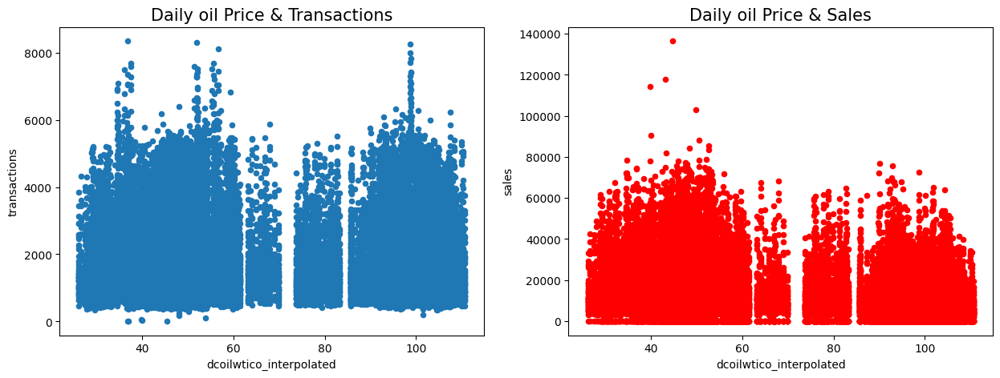

In [1006]:
temp = pd.merge(temp, oil, how = "left")
print("Correlation with Daily Oil Prices")
print(temp.drop(["store_nbr", "dcoilwtico"], axis = 1).corr("spearman").dcoilwtico_interpolated.loc[["sales", "transactions"]], "\n")

fig, axes = plt.subplots(1, 2, figsize = (15, 5))
temp.plot.scatter(x = "dcoilwtico_interpolated", y = "transactions", ax = axes[0])
temp.plot.scatter(x = "dcoilwtico_interpolated", y = "sales", ax = axes[1], color = "r")
axes[0].set_title('Daily oil Price & Transactions', fontsize = 15)
axes[1].set_title('Daily oil Price & Sales', fontsize = 15);

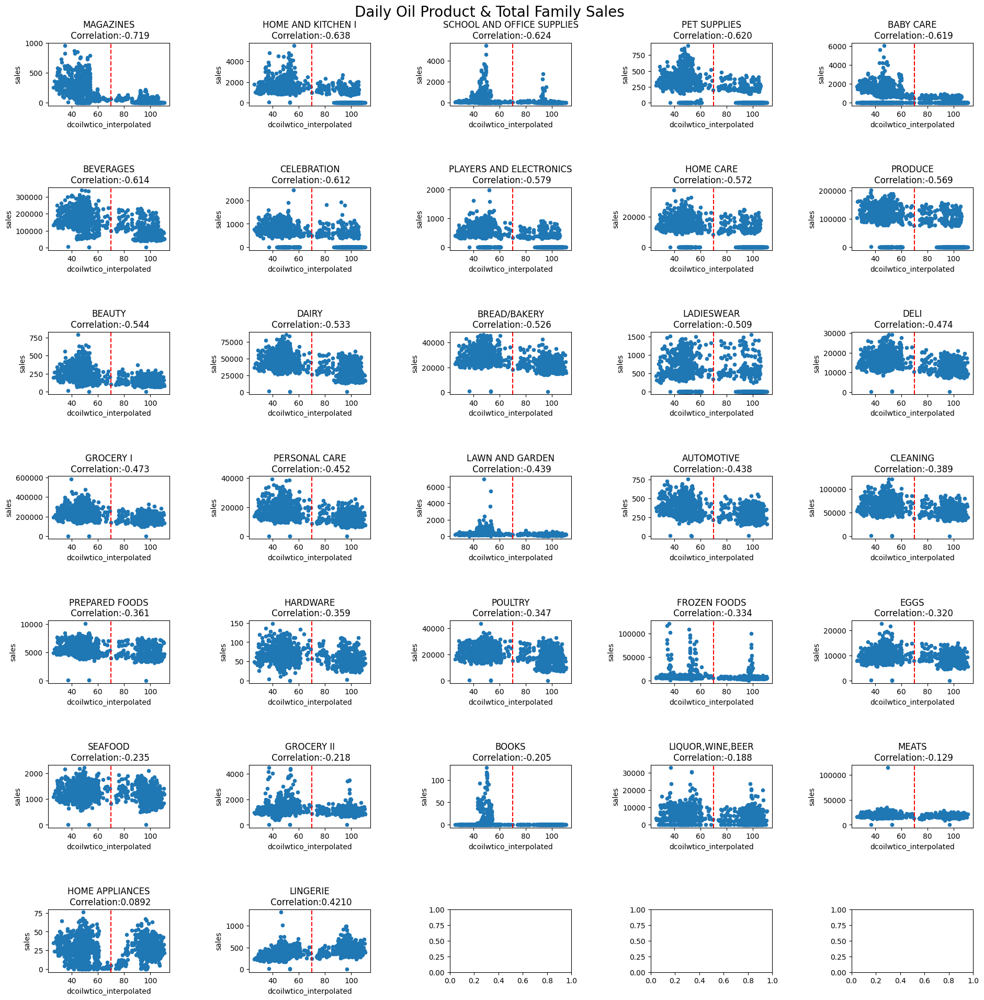

In [1007]:
a = pd.merge(train_data.groupby(["date", "family"]).sales.sum().reset_index(), oil.drop("dcoilwtico", axis = 1), how = "left")
c = a.groupby("family").corr("spearman").reset_index()
c = c[c.level_1 == "dcoilwtico_interpolated"][["family", "sales"]].sort_values("sales")

fig, axes = plt.subplots(7, 5, figsize = (20,20))
for i, fam in enumerate(c.family):
    if i < 6:
        a[a.family == fam].plot.scatter(x = "dcoilwtico_interpolated", y = "sales", ax=axes[0, i-1])
        axes[0, i-1].set_title(fam+"\n Correlation:"+str(c[c.family == fam].sales.iloc[0])[:6], fontsize = 12)
        axes[0, i-1].axvline(x=70, color='r', linestyle='--')
    if i >= 6 and i<11:
        a[a.family == fam].plot.scatter(x = "dcoilwtico_interpolated", y = "sales", ax=axes[1, i-6])
        axes[1, i-6].set_title(fam+"\n Correlation:"+str(c[c.family == fam].sales.iloc[0])[:6], fontsize = 12)
        axes[1, i-6].axvline(x=70, color='r', linestyle='--')
    if i >= 11 and i<16:
        a[a.family == fam].plot.scatter(x = "dcoilwtico_interpolated", y = "sales", ax=axes[2, i-11])
        axes[2, i-11].set_title(fam+"\n Correlation:"+str(c[c.family == fam].sales.iloc[0])[:6], fontsize = 12)
        axes[2, i-11].axvline(x=70, color='r', linestyle='--')
    if i >= 16 and i<21:
        a[a.family == fam].plot.scatter(x = "dcoilwtico_interpolated", y = "sales", ax=axes[3, i-16])
        axes[3, i-16].set_title(fam+"\n Correlation:"+str(c[c.family == fam].sales.iloc[0])[:6], fontsize = 12)
        axes[3, i-16].axvline(x=70, color='r', linestyle='--')
    if i >= 21 and i<26:
        a[a.family == fam].plot.scatter(x = "dcoilwtico_interpolated", y = "sales", ax=axes[4, i-21])
        axes[4, i-21].set_title(fam+"\n Correlation:"+str(c[c.family == fam].sales.iloc[0])[:6], fontsize = 12)
        axes[4, i-21].axvline(x=70, color='r', linestyle='--')
    if i >= 26 and i < 31:
        a[a.family == fam].plot.scatter(x = "dcoilwtico_interpolated", y = "sales", ax=axes[5, i-26])
        axes[5, i-26].set_title(fam+"\n Correlation:"+str(c[c.family == fam].sales.iloc[0])[:6], fontsize = 12)
        axes[5, i-26].axvline(x=70, color='r', linestyle='--')
    if i >= 31 :
        a[a.family == fam].plot.scatter(x = "dcoilwtico_interpolated", y = "sales", ax=axes[6, i-31])
        axes[6, i-31].set_title(fam+"\n Correlation:"+str(c[c.family == fam].sales.iloc[0])[:6], fontsize = 12)
        axes[6, i-31].axvline(x=70, color='r', linestyle='--')
        
        
plt.tight_layout(pad=5)
plt.suptitle("Daily Oil Product & Total Family Sales \n", fontsize = 20);
plt.show()

### Analyze by visualizing data(Sales Data)

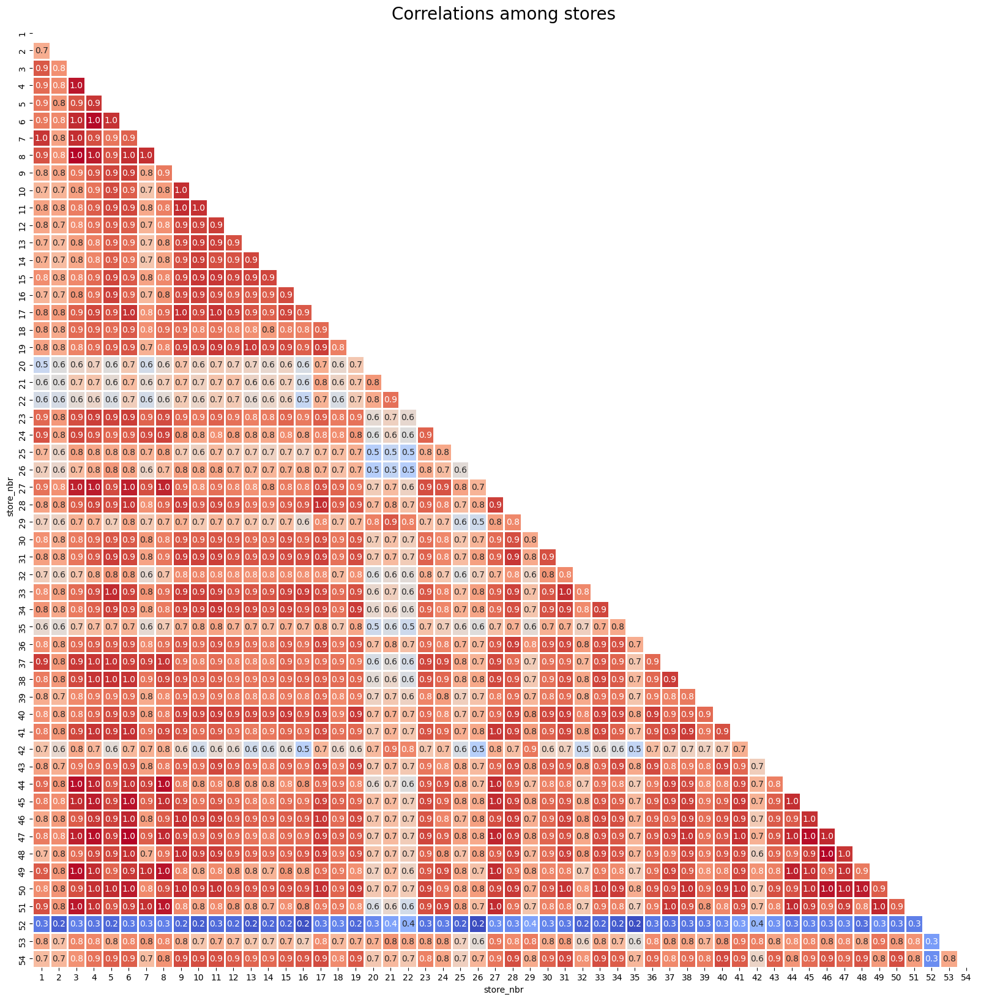

In [1008]:
a = train_data[["store_nbr", "sales"]]
a["ind"] = 1
a["ind"] = a.groupby("store_nbr").ind.cumsum().values
a = pd.pivot(a, index = "ind", columns = "store_nbr", values = "sales").corr()
mask = np.triu(a.corr())
plt.figure(figsize = (20,20))
sns.heatmap(a,
        annot = True,
        fmt = '.1f',
        cmap = 'coolwarm',
        square = True,
        mask = mask,
        linewidths = 1,
        cbar = False)
plt.title("Correlations among stores", fontsize = 20)
plt.show()

<h6> * Note(graph analysis)<br>
- Most of the stores are silmilar to each other<br>
- Some stores(20, 21, 22, 52) may be a little different
</h6>

In [1009]:
a = train_data.set_index("date").groupby("store_nbr").resample("D").sales.sum().reset_index()
px.line(a, x = "date", y = "sales", color = "store_nbr", title = "Daily total sales of the stores")

In [1010]:
print(train_data.shape)
train_data = train_data[~((train_data.store_nbr == 52) & (train_data.date < "2017-04-20"))]
train_data = train_data[~((train_data.store_nbr == 22) & (train_data.date < "2015-10-09"))]
train_data = train_data[~((train_data.store_nbr == 42) & (train_data.date < "2015-08-21"))]
train_data = train_data[~((train_data.store_nbr == 21) & (train_data.date < "2015-07-24"))]
train_data = train_data[~((train_data.store_nbr == 29) & (train_data.date < "2015-03-20"))]
train_data = train_data[~((train_data.store_nbr == 20) & (train_data.date < "2015-02-13"))]
train_data = train_data[~((train_data.store_nbr == 53) & (train_data.date < "2014-05-29"))]
train_data = train_data[~((train_data.store_nbr == 36) & (train_data.date < "2013-05-09"))]
train_data.shape

(3000888, 6)


(2780316, 6)

In [1011]:
# Zero Forecasting
c = train_data.groupby(["store_nbr", "family"]).sales.sum().reset_index().sort_values(["family", "store_nbr"])
c = c[c.sales==0]
c

,store_nbr,family,sales
1,1,BABY CARE,0.00
397,13,BABY CARE,0.00
727,23,BABY CARE,0.00
1420,44,BABY CARE,0.00
1453,45,BABY CARE,0.00
1486,46,BABY CARE,0.00
1519,47,BABY CARE,0.00
1552,48,BABY CARE,0.00
1585,49,BABY CARE,0.00
1618,50,BABY CARE,0.00


In [1012]:
print(train_data.shape)
# Anti Join
outer_join = train_data.merge(c[c.sales == 0].drop("sales", axis = 1), how = 'outer', indicator = True)
train_data = outer_join[~(outer_join._merge == 'both')].drop('_merge', axis = 1)
del outer_join
gc.collect()
train_data.shape

(2780316, 6)


(2698648, 6)

In [1013]:
zero_prediction = []
for i in range(0, len(c)):
    zero_prediction.append(
        pd.DataFrame({
            "date":pd.date_range("2017-08-16", "2017-08-31").tolist(),
            "store_nbr":c.store_nbr.iloc[i],
            "family":c.family.iloc[i],
            "sales":0
            })
    )
zero_prediction = pd.concat(zero_prediction)
del c
gc.collect()
zero_prediction

,date,store_nbr,family,sales
0,2017-08-16,1,BABY CARE,0
1,2017-08-17,1,BABY CARE,0
2,2017-08-18,1,BABY CARE,0
3,2017-08-19,1,BABY CARE,0
4,2017-08-20,1,BABY CARE,0
...,...,...,...,...
11,2017-08-27,54,LAWN AND GARDEN,0
12,2017-08-28,54,LAWN AND GARDEN,0
13,2017-08-29,54,LAWN AND GARDEN,0
14,2017-08-30,54,LAWN AND GARDEN,0


In [1014]:
c = train_data.groupby(["family", "store_nbr"]).tail(60).groupby(["family", "store_nbr"]).sales.sum().reset_index()

In [1015]:
c[c.sales == 0]

,family,store_nbr,sales
54,BABY CARE,2,0.00
62,BABY CARE,10,0.00
64,BABY CARE,12,0.00
65,BABY CARE,14,0.00
76,BABY CARE,26,0.00
82,BABY CARE,32,0.00
83,BABY CARE,33,0.00
87,BABY CARE,37,0.00
88,BABY CARE,38,0.00
92,BABY CARE,42,0.00


In [1016]:
train_data

,id,date,store_nbr,family,sales,onpromotion
0,0,2013-01-01,1,AUTOMOTIVE,0.00,0.00
1,1782,2013-01-02,1,AUTOMOTIVE,2.00,0.00
2,3564,2013-01-03,1,AUTOMOTIVE,3.00,0.00
3,5346,2013-01-04,1,AUTOMOTIVE,3.00,0.00
4,7128,2013-01-05,1,AUTOMOTIVE,5.00,0.00
...,...,...,...,...,...,...
2780311,2993561,2017-08-11,52,SEAFOOD,23.00,3.00
2780312,2995343,2017-08-12,52,SEAFOOD,5.00,0.00
2780313,2997125,2017-08-13,52,SEAFOOD,12.00,0.00
2780314,2998907,2017-08-14,52,SEAFOOD,6.60,0.00


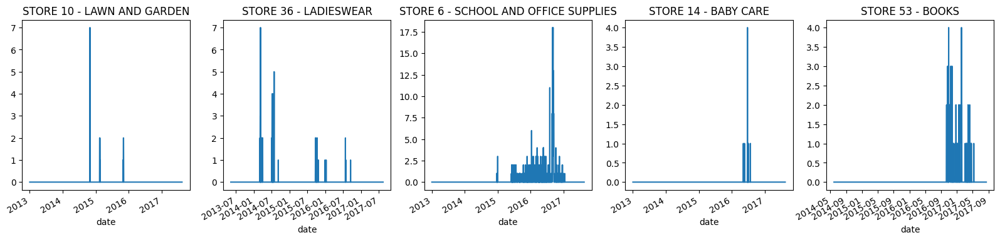

In [1017]:
fig, ax = plt.subplots(1, 5, figsize = (20, 4))
train_data[(train_data.store_nbr == 10) & (train_data.family == "LAWN AND GARDEN")].set_index("date").sales.plot(ax = ax[0], title = "STORE 10 - LAWN AND GARDEN")
train_data[(train_data.store_nbr == 36) & (train_data.family == "LADIESWEAR")].set_index("date").sales.plot(ax = ax[1], title = "STORE 36 - LADIESWEAR")
train_data[(train_data.store_nbr == 6) & (train_data.family == "SCHOOL AND OFFICE SUPPLIES")].set_index("date").sales.plot(ax = ax[2], title = "STORE 6 - SCHOOL AND OFFICE SUPPLIES")
train_data[(train_data.store_nbr == 14) & (train_data.family == "BABY CARE")].set_index("date").sales.plot(ax = ax[3], title = "STORE 14 - BABY CARE")
train_data[(train_data.store_nbr == 53) & (train_data.family == "BOOKS")].set_index("date").sales.plot(ax = ax[4], title = "STORE 53 - BOOKS")
plt.show()

In [1018]:
a = train_data.set_index("date").groupby("family").resample("D").sales.sum().reset_index()
px.line(a, x = "date", y = "sales", color = "family", title = "Daily total sales of the family")

In [1019]:
a = train_data.groupby("family").sales.sum().sort_values(ascending = False).reset_index()
px.bar(a, y = "family", x = "sales", color = "family", title = "Which product family preferred more?")

In [1020]:
print("Spearman Correlation between Sales and Onpromotion:{:,.4f}".format(train_data.corr("spearman").sales.loc["onpromotion"]))

Spearman Correlation between Sales and Onpromotion:0.5304


In [1021]:
d = pd.merge(train_data, stores)
d["store_nbr"] = d["store_nbr"].astype("int8")
d["year"] = d.date.dt.year
px.line(d.groupby(["city", "year"]).sales.mean().reset_index(), x = "year", y = "sales", color = "city")

### Analyze data(hoildays and events)

In [1022]:
# transferred holidays
tr1 = holi[(holi.type == "Holiday") & (holi.transferred == True)].drop("transferred", axis = 1).reset_index(drop = True)
tr2 = holi[(holi.type == "Transfer")].drop("transferred", axis = 1).reset_index(drop = True)
tr = pd.concat([tr1, tr2], axis = 1)
tr = tr.iloc[:, [5, 1, 2, 3, 4]]

holi = holi[(holi.transferred == False) & (holi.type != "Transfer")].drop("transferred", axis = 1)
holi = holi.append(tr).reset_index(drop = True)

# additional holidays
holi["description"] = holi["description"].str.replace("-", "").str.replace("+", "").str.replace("\d+", "")
holi["type"] = np.where(holi["type"] == "Additional", "Holiday", holi["type"])

# bridge holidays
holi["description"] = holi["description"].str.replace("Puente", "")
holi["type"] = np.where(holi["type"] == "Bridge", "Holiday", holi["type"])

# work day holidays, that is meant to payback the bridge
work_day = holi[holi.type == "Work Day"]
holi = holi[holi.type != "Work Day"]

# split
# events are national
events = holi[holi.type == "Event"].drop(["type", "locale", "locale_name"], axis = 1).rename({"description":"events"}, axis = 1)

holi = holi[holi.type != "Event"].drop("type", axis = 1)
regional = holi[holi.locale == "Regional"].rename({"locale_name":"state", "description":"holiday_regional"}, axis = 1).drop("locale", axis = 1).drop_duplicates()
national = holi[holi.locale == "National"].rename({"description":"holiday_national"}, axis = 1).drop(["locale", "locale_name"], axis = 1).drop_duplicates()
local = holi[holi.locale == "Local"].rename({"description":"holiday_local", "locale_name":"city"}, axis = 1).drop("locale", axis = 1).drop_duplicates()

d = pd.merge(train_data.append(test_data), stores)
d["store_nbr"] = d["store_nbr"].astype("int8")

# national holidays & events
d = pd.merge(d, national, how = "left")
# regional
d = pd.merge(d, regional, how = "left", on = ["date", "state"])
# local
d = pd.merge(d, local, how = "left", on = ["date", "city"])
# work day
d = pd.merge(d, work_day[["date", "type"]].rename({"type":"IsWorkDay"}, axis = 1), how = "left")
# events
events["events"] = np.where(events.events.str.contains("futbol"), "Futbol", events.events)

def one_hot_encoder(df, nan_as_category = True):
    original_columns = list(df.columns)
    categorical_columns = df.select_dtypes(["category", "object"]).columns.tolist()
    df = pd.get_dummies(df, columns = categorical_columns, dummy_na = nan_as_category)
    new_columns = [c for c in df.columns if c not in original_columns]
    df.columns = df.columns.str.replace(" ", "_")
    return df, df.columns.tolist()

events, events_cat = one_hot_encoder(events, nan_as_category = False)
events["events_Dia_de_la_Madre"] = np.where(events.date == "2016-05-08", 1, events["events_Dia_de_la_Madre"])
events = events.drop(239)

d = pd.merge(d, events, how = "left")
d[events_cat] = d[events_cat].fillna(0)

# new features
d["holiday_national_binary"] = np.where(d.holiday_national.notnull(), 1, 0)
d["holiday_local_binary"] = np.where(d.holiday_local.notnull(), 1, 0)
d["holiday_regional_binary"] = np.where(d.holiday_regional.notnull(), 1, 0)

#
d["national_independence"] = np.where(d.holiday_national.isin(['Batalla de Pichincha', 'Independencia de Cuenca', 'Independencia de Guayaquil', 'Independencia de Guayaquil', 'Primer Grito de Independencia']), 1, 0)
d["local_cantonizacio"] = np.where(d.holiday_local.str.contains("Cantonizacio"), 1, 0)
d["local_fundacion"] = np.where(d.holiday_local.str.contains("Fundacion"), 1, 0)
d["local_independencia"] = np.where(d.holiday_local.str.contains("Independencia"), 1, 0)

holi, holi_cat = one_hot_encoder(d[["holiday_national", "holiday_regional", "holiday_local"]], nan_as_category = False)
d = pd.concat([d.drop(["holiday_national", "holiday_regional", "holiday_local"], axis = 1), holi], axis = 1)

he_cols = d.columns[d.columns.str.startswith("events")].tolist() + d.columns[d.columns.str.startswith("holi")].tolist() + d.columns[d.columns.str.startswith("national")].tolist() + d.columns[d.columns.str.startswith("local")].tolist()
d[he_cols] = d[he_cols].astype("int8")

d[["family", "city", "state", "type"]] = d[["family", "city", "state", "type"]].astype("category")

del holi, holi_cat, work_day, local, regional, national, events, events_cat, tr, tr1, tr2, he_cols
gc.collect()

d.head(10)

,id,date,store_nbr,family,sales,onpromotion,city,state,type,cluster,IsWorkDay,events_Black_Friday,events_Cyber_Monday,events_Dia_de_la_Madre,events_Futbol,events_Terremoto_Manabi,holiday_national_binary,holiday_local_binary,holiday_regional_binary,national_independence,local_cantonizacio,local_fundacion,local_independencia,holiday_national__Dia_de_Difuntos,holiday_national__Navidad,holiday_national__Primer_dia_del_ano,holiday_national_Batalla_de_Pichincha,holiday_national_Carnaval,holiday_national_Dia_de_Difuntos,holiday_national_Dia_de_la_Madre,holiday_national_Dia_del_Trabajo,holiday_national_Independencia_de_Cuenca,holiday_national_Independencia_de_Guayaquil,holiday_national_Navidad,holiday_national_Primer_Grito_de_Independencia,holiday_national_Primer_dia_del_ano,holiday_national_Viernes_Santo,holiday_regional_Provincializacion_Santa_Elena,holiday_regional_Provincializacion_de_Cotopaxi,holiday_regional_Provincializacion_de_Imbabura,holiday_regional_Provincializacion_de_Santo_Domingo,holiday_local_Cantonizacion_de_Cayambe,holiday_local_Cantonizacion_de_El_Carmen,holiday_local_Cantonizacion_de_Guaranda,holiday_local_Cantonizacion_de_Latacunga,holiday_local_Cantonizacion_de_Libertad,holiday_local_Cantonizacion_de_Quevedo,holiday_local_Cantonizacion_de_Riobamba,holiday_local_Cantonizacion_de_Salinas,holiday_local_Cantonizacion_del_Puyo,holiday_local_Fundacion_de_Ambato,holiday_local_Fundacion_de_Cuenca,holiday_local_Fundacion_de_Esmeraldas,holiday_local_Fundacion_de_Guayaquil,holiday_local_Fundacion_de_Ibarra,holiday_local_Fundacion_de_Loja,holiday_local_Fundacion_de_Machala,holiday_local_Fundacion_de_Manta,holiday_local_Fundacion_de_Quito,holiday_local_Fundacion_de_Riobamba,holiday_local_Fundacion_de_Santo_Domingo,holiday_local_Independencia_de_Ambato,holiday_local_Independencia_de_Guaranda,holiday_local_Independencia_de_Latacunga
0,0,2013-01-01,1,AUTOMOTIVE,0.00,0.00,Quito,Pichincha,D,13,NaN,0,0,0,0,0,1,0,0,0,1,1,1,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
1,1782,2013-01-02,1,AUTOMOTIVE,2.00,0.00,Quito,Pichincha,D,13,NaN,0,0,0,0,0,0,0,0,0,1,1,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
2,3564,2013-01-03,1,AUTOMOTIVE,3.00,0.00,Quito,Pichincha,D,13,NaN,0,0,0,0,0,0,0,0,0,1,1,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
3,5346,2013-01-04,1,AUTOMOTIVE,3.00,0.00,Quito,Pichincha,D,13,NaN,0,0,0,0,0,0,0,0,0,1,1,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
4,7128,2013-01-05,1,AUTOMOTIVE,5.00,0.00,Quito,Pichincha,D,13,Work Day,0,0,0,0,0,0,0,0,0,1,1,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
5,8910,2013-01-06,1,AUTOMOTIVE,2.00,0.00,Quito,Pichincha,D,13,NaN,0,0,0,0,0,0,0,0,0,1,1,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
6,10692,2013-01-07,1,AUTOMOTIVE,0.00,0.00,Quito,Pichincha,D,13,NaN,0,0,0,0,0,0,0,0,0,1,1,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
7,12474,2013-01-08,1,AUTOMOTIVE,2.00,0.00,Quito,Pichincha,D,13,NaN,0,0,0,0,0,0,0,0,0,1,1,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
8,14256,2013-01-09,1,AUTOMOTIVE,2.00,0.00,Quito,Pichincha,D,13,NaN,0,0,0,0,0,0,0,0,0,1,1,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
9,16038,2013-01-10,1,AUTOMOTIVE,2.00,0.00,Quito,Pichincha,D,13,NaN,0,0,0,0,0,0,0,0,0,1,1,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0


### Apply an AB test to events and holidays features
<h6> H0: The sales are equal(M1 = M2)<br>
H1: The sales are not equal(M1 != M2)
</h6>

In [1023]:
def AB_Test(dataframe, group, target):

    # packasges
    from scipy.stats import shapiro
    import scipy.stats as stats

    # split AB
    groupA = dataframe[dataframe[group] == 1][target]
    groupB = dataframe[dataframe[group] == 0][target]

    # assumption: normality
    ntA = shapiro(groupA)[1] < 0.05
    ntB = shapiro(groupB)[1] < 0.05
    # H0: distribution is normal! - False
    # H1: distribution is not notmal! - True

    if (ntA == False) & (ntB == False): # H0: normal distribution
        # parametric test, assumption: homogeneity of variances
        leveneTest = stats.levene(groupA, groupB)[1] < 0.05
        # H0: homogeneity: False
        # H1: heterogeneous: True

        if leveneTest == False:
            # homogeneity
            ttest = stats.ttest_ind(groupA, groupB, equal_var = True)[1]
            # H0: M1 == M2 - False
            # H1: M1 != M2 - True
        else:
            # heterogeneous
            ttest = stats.ttest_ind(groupA, groupB, equal_var = False)[1]
            # H0: M1 == M2 - False
            # H1: M1 != M2 - True
    else:
        # non_parametric test
        ttest = stats.mannwhitneyu(groupA, groupB)[1]
        # H0: M1 == M2 - False
        # H1: M1 != M2 - True
    
    # result
    temp = pd.DataFrame({
        "AB Hypothesis" : [ttest < 0.05],
        "p-value":[ttest]
    })
    temp["Test Type"] = np.where((ntA == False) & (ntB == False), "Parametric", "Non-Parametric")
    temp["AB Hypothesis"] = np.where(temp["AB Hypothesis"] == False, "Fail to Reject H0", "Reject H0")
    temp["Comment"] = np.where(temp["AB Hypothesis"] == "Fail to Reject H0", "A/B groups are similar!", "A/B groups are not similar!")
    temp["Feature"] = group
    temp["GroupA_mean"] = groupA.mean()
    temp["GroupB_mean"] = groupB.mean()
    temp["GroupA_median"] = groupA.median()
    temp["GroupB_median"] = groupB.median()

    # columns
    if (ntA == False) & (ntB == False):
        temp["Homogeneity"] = np.where(leveneTest == False, "Yes", "No")
        temp = temp[["Feature", "Test Type", "Homogeneity", "AB Hypothesis", "p-value", "Comment", "GroupA_mean", "GroupB_mean", "GroupA_median", "GroupB_median"]]
    else:
        temp = temp[["Feature", "Test Type", "AB Hypothesis", "p-value", "Comment", "GroupA_mean", "GroupB_mean", "GroupA_median", "GroupB_median"]]
    return temp

# apply A/B testing
he_cols = d.columns[d.columns.str.startswith("events")].tolist() + d.columns[d.columns.str.startswith("holiday")].tolist() + d.columns[d.columns.str.startswith("national")].tolist() + d.columns[d.columns.str.startswith("local")].tolist()
ab = []
for i in he_cols:
    ab.append(AB_Test(dataframe = d[d.sales.notnull()], group = i, target = "sales"))
ab = pd.concat(ab)
ab

,Feature,Test Type,AB Hypothesis,p-value,Comment,GroupA_mean,GroupB_mean,GroupA_median,GroupB_median
0,events_Black_Friday,Non-Parametric,Reject H0,0.00,A/B groups are not similar!,393.70,397.95,26.58,19.00
0,events_Cyber_Monday,Non-Parametric,Reject H0,0.00,A/B groups are not similar!,472.65,397.81,24.00,19.00
0,events_Dia_de_la_Madre,Non-Parametric,Reject H0,0.00,A/B groups are not similar!,386.35,397.98,17.00,19.00
0,events_Futbol,Non-Parametric,Reject H0,0.00,A/B groups are not similar!,360.30,398.24,13.00,19.00
0,events_Terremoto_Manabi,Non-Parametric,Reject H0,0.00,A/B groups are not similar!,519.39,395.53,30.00,19.00
0,holiday_national_binary,Non-Parametric,Reject H0,0.00,A/B groups are not similar!,472.58,394.27,20.00,19.00
0,holiday_local_binary,Non-Parametric,Reject H0,0.00,A/B groups are not similar!,472.89,397.64,24.00,19.00
0,holiday_regional_binary,Non-Parametric,Reject H0,0.00,A/B groups are not similar!,254.61,397.99,11.00,19.00
0,holiday_national__Dia_de_Difuntos,Non-Parametric,Reject H0,0.00,A/B groups are not similar!,505.58,397.87,32.00,19.00
0,holiday_national__Navidad,Non-Parametric,Reject H0,0.00,A/B groups are not similar!,567.03,397.85,47.07,19.00


In [1024]:
d.groupby(["family", "events_Futbol"]).sales.mean()[:60]

family                   events_Futbol
AUTOMOTIVE               0                  6.59
                         1                  6.20
BABY CARE                0                  0.15
                         1                  0.09
BEAUTY                   0                  4.02
                         1                  2.89
BEVERAGES                0               2578.53
                         1               2243.45
BOOKS                    0                  0.15
                         1                  0.00
BREAD/BAKERY             0                500.50
                         1                451.53
CELEBRATION              0                  9.06
                         1                  6.43
CLEANING                 0               1158.23
                         1               1102.08
DAIRY                    0                765.52
                         1                759.26
DELI                     0                286.39
                         1    

### Time related features

In [1025]:
# time related features
def create_date_features(df):
    df['month'] = df.date.dt.month.astype("int8")
    df['day_of_month'] = df.date.dt.day.astype("int8")
    df['day_of_year'] = df.date.dt.dayofyear.astype("int16")
    df['week_of_month'] = (df.date.apply(lambda d:(d.day-1) // 7 + 1)).astype("int8")
    df['week_of_year'] = (df.date.dt.weekofyear).astype("int8")
    df['day_of_week']  = (df.date.dt.dayofweek + 1).astype("int8")
    df['year'] = df.date.dt.year.astype("int32")
    df['is_wknd'] = (df.date.dt.weekday // 4).astype("int8")
    df['quarter'] = df.date.dt.quarter.astype("int8")
    df['is_month_start'] = df.date.dt.is_month_start.astype("int8")
    df['is_month_end'] = df.date.dt.is_month_end.astype("int8")
    df['is_quarter_start'] = df.date.dt.is_quarter_start.astype("int8")
    df['is_year_start'] = df.date.dt.is_year_start.astype("int8")
    df['is_year_end'] = df.date.dt.is_year_end.astype("int8")
    # 0: winther 1: spring 2: summer 3: fall
    df["season"] = np.where(df.month.isin([12, 1, 2]), 0, 1)
    df["season"] = np.where(df.month.isin([6, 7, 8]), 2, df["season"])
    df["season"] = pd.Series(np.where(df.month.isin([9, 10, 11]), 3, df["season"])).astype("int8")
    return df
d = create_date_features(d)

# workday column
d["workday"] = np.where((d.holiday_national_binary == 1) | (d.holiday_local_binary == 1) | (d.holiday_regional_binary == 1) | (d['day_of_week'].isin([6, 7])), 0, 1)
d["workday"] = pd.Series(np.where(d.IsWorkDay.notnull(), 1, d["workday"])).astype("int8")
d.drop("IsWorkDay", axis = 1, inplace = True)

# wages in the public sector are paid every two weeks on the 15th and on th last day of the month
# supermarket sales could be affected by this
d["wageday"] = pd.Series(np.where((d['is_month_end'] == 1) | (d["day_of_month"] == 15), 1, 0)).astype("int8")

d.head(15)

,id,date,store_nbr,family,sales,onpromotion,city,state,type,cluster,events_Black_Friday,events_Cyber_Monday,events_Dia_de_la_Madre,events_Futbol,events_Terremoto_Manabi,holiday_national_binary,holiday_local_binary,holiday_regional_binary,national_independence,local_cantonizacio,local_fundacion,local_independencia,holiday_national__Dia_de_Difuntos,holiday_national__Navidad,holiday_national__Primer_dia_del_ano,holiday_national_Batalla_de_Pichincha,holiday_national_Carnaval,holiday_national_Dia_de_Difuntos,holiday_national_Dia_de_la_Madre,holiday_national_Dia_del_Trabajo,holiday_national_Independencia_de_Cuenca,holiday_national_Independencia_de_Guayaquil,holiday_national_Navidad,holiday_national_Primer_Grito_de_Independencia,holiday_national_Primer_dia_del_ano,holiday_national_Viernes_Santo,holiday_regional_Provincializacion_Santa_Elena,holiday_regional_Provincializacion_de_Cotopaxi,holiday_regional_Provincializacion_de_Imbabura,holiday_regional_Provincializacion_de_Santo_Domingo,holiday_local_Cantonizacion_de_Cayambe,holiday_local_Cantonizacion_de_El_Carmen,holiday_local_Cantonizacion_de_Guaranda,holiday_local_Cantonizacion_de_Latacunga,holiday_local_Cantonizacion_de_Libertad,holiday_local_Cantonizacion_de_Quevedo,holiday_local_Cantonizacion_de_Riobamba,holiday_local_Cantonizacion_de_Salinas,holiday_local_Cantonizacion_del_Puyo,holiday_local_Fundacion_de_Ambato,holiday_local_Fundacion_de_Cuenca,holiday_local_Fundacion_de_Esmeraldas,holiday_local_Fundacion_de_Guayaquil,holiday_local_Fundacion_de_Ibarra,holiday_local_Fundacion_de_Loja,holiday_local_Fundacion_de_Machala,holiday_local_Fundacion_de_Manta,holiday_local_Fundacion_de_Quito,holiday_local_Fundacion_de_Riobamba,holiday_local_Fundacion_de_Santo_Domingo,holiday_local_Independencia_de_Ambato,holiday_local_Independencia_de_Guaranda,holiday_local_Independencia_de_Latacunga,month,day_of_month,day_of_year,week_of_month,week_of_year,day_of_week,year,is_wknd,quarter,is_month_start,is_month_end,is_quarter_start,is_year_start,is_year_end,season,workday,wageday
0,0,2013-01-01,1,AUTOMOTIVE,0.00,0.00,Quito,Pichincha,D,13,0,0,0,0,0,1,0,0,0,1,1,1,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,1,1,1,1,2,2013,0,1,1,0,1,1,0,0,0,0
1,1782,2013-01-02,1,AUTOMOTIVE,2.00,0.00,Quito,Pichincha,D,13,0,0,0,0,0,0,0,0,0,1,1,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,2,2,1,1,3,2013,0,1,0,0,0,0,0,0,1,0
2,3564,2013-01-03,1,AUTOMOTIVE,3.00,0.00,Quito,Pichincha,D,13,0,0,0,0,0,0,0,0,0,1,1,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,3,3,1,1,4,2013,0,1,0,0,0,0,0,0,1,0
3,5346,2013-01-04,1,AUTOMOTIVE,3.00,0.00,Quito,Pichincha,D,13,0,0,0,0,0,0,0,0,0,1,1,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,4,4,1,1,5,2013,1,1,0,0,0,0,0,0,1,0
4,7128,2013-01-05,1,AUTOMOTIVE,5.00,0.00,Quito,Pichincha,D,13,0,0,0,0,0,0,0,0,0,1,1,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,5,5,1,1,6,2013,1,1,0,0,0,0,0,0,1,0
5,8910,2013-01-06,1,AUTOMOTIVE,2.00,0.00,Quito,Pichincha,D,13,0,0,0,0,0,0,0,0,0,1,1,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,6,6,1,1,7,2013,1,1,0,0,0,0,0,0,0,0
6,10692,2013-01-07,1,AUTOMOTIVE,0.00,0.00,Quito,Pichincha,D,13,0,0,0,0,0,0,0,0,0,1,1,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,7,7,1,2,1,2013,0,1,0,0,0,0,0,0,1,0
7,12474,2013-01-08,1,AUTOMOTIVE,2.00,0.00,Quito,Pichincha,D,13,0,0,0,0,0,0,0,0,0,1,1,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,8,8,2,2,2,2013,0,1,0,0,0,0,0,0,1,0
8,14256,2013-01-09,1,AUTOMOTIVE,2.00,0.00,Quito,Pichincha,D,13,0,0,0,0,0,0,0,0,0,1,1,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,9,9,2,2,3,2013,0,1,0,0,0,0,0,0,1,0
9,16038,2013-01-10,1,AUTOMOTIVE,2.00,0.00,Quito,Pichincha,D,13,0,0,0,0,0,0,0,0,0,1,1,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0

### Earhquake influence about the store sales

In [1026]:
# march
d[(d.month.isin([4, 5]))].groupby(["year"]).sales.mean()

year
2013   249.38
2014   285.53
2015   334.68
2016   489.90
2017   503.50
Name: sales, dtype: float32

In [1027]:
# april - may
pd.pivot_table(d[(d.month.isin([3]))], index = "year", columns = "family", values = "sales", aggfunc = "mean")

family,AUTOMOTIVE,BABY CARE,BEAUTY,BEVERAGES,BOOKS,BREAD/BAKERY,CELEBRATION,CLEANING,DAIRY,DELI,EGGS,FROZEN FOODS,GROCERY I,GROCERY II,HARDWARE,HOME AND KITCHEN I,HOME AND KITCHEN II,HOME APPLIANCES,HOME CARE,LADIESWEAR,LAWN AND GARDEN,LINGERIE,"LIQUOR,WINE,BEER",MAGAZINES,MEATS,PERSONAL CARE,PET SUPPLIES,PLAYERS AND ELECTRONICS,POULTRY,PREPARED FOODS,PRODUCE,SCHOOL AND OFFICE SUPPLIES,SEAFOOD
year,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
2013,5.35,0.00,2.74,1277.85,0.00,416.57,0.00,1055.67,429.53,229.49,157.80,95.06,3281.80,20.69,1.11,0.00,0.00,0.80,0.00,0.00,3.31,9.33,74.50,0.00,368.54,223.88,0.00,0.00,223.56,106.08,2.83,0.00,28.10
2014,6.94,0.06,3.55,3040.63,0.00,446.92,14.74,1215.01,815.26,261.29,189.67,138.42,3807.03,21.25,1.50,23.82,12.52,0.71,297.74,16.65,5.63,8.49,95.85,1.34,382.59,265.75,5.50,11.02,449.17,112.42,2300.86,1.53,27.45
2015,7.55,0.00,2.78,1515.37,0.00,547.43,0.00,1219.26,806.57,329.61,209.24,129.68,4016.91,23.82,1.13,24.85,18.66,0.85,0.00,0.00,5.35,6.52,91.09,0.00,356.97,316.62,0.00,0.00,420.88,104.59,4.51,0.00,28.61
2016,7.34,0.34,4.34,3023.50,0.00,501.95,14.23,1077.72,859.32,277.81,177.58,131.25,4088.61,19.78,1.32,26.11,25.67,0.31,267.45,13.88,5.35,4.92,89.79,6.07,330.77,296.47,5.89,8.72,374.97,109.86,2304.82,1.96,23.89
2017,7.79,0.34,4.29,3733.14,0.59,584.24,14.21,1220.11,991.14,326.49,199.83,130.17,4800.77,22.14,1.45,29.23,29.95,0.71,319.10,14.74,15.97,6.88,89.70,6.28,374.28,331.43,8.79,11.39,395.35,114.03,2442.19,5.02,25.54


In [1028]:
# june
pd.pivot_table(d[(d.month.isin([6]))], index = "year", columns = "family", values = "sales", aggfunc = "mean")

family,AUTOMOTIVE,BABY CARE,BEAUTY,BEVERAGES,BOOKS,BREAD/BAKERY,CELEBRATION,CLEANING,DAIRY,DELI,EGGS,FROZEN FOODS,GROCERY I,GROCERY II,HARDWARE,HOME AND KITCHEN I,HOME AND KITCHEN II,HOME APPLIANCES,HOME CARE,LADIESWEAR,LAWN AND GARDEN,LINGERIE,"LIQUOR,WINE,BEER",MAGAZINES,MEATS,PERSONAL CARE,PET SUPPLIES,PLAYERS AND ELECTRONICS,POULTRY,PREPARED FOODS,PRODUCE,SCHOOL AND OFFICE SUPPLIES,SEAFOOD
year,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
2013,5.89,0.00,2.72,1297.24,0.00,431.05,0.00,1052.44,419.08,238.23,156.45,120.79,3489.13,21.83,0.95,0.00,0.00,0.71,0.00,0.00,3.43,8.85,75.67,0.00,389.95,216.12,0.00,0.00,232.16,100.72,6.12,0.00,20.99
2014,5.72,0.00,2.46,1458.94,0.00,450.82,0.00,1029.45,757.82,260.01,182.69,122.18,3655.15,22.99,1.03,0.00,0.00,0.41,0.00,0.00,4.35,8.60,94.37,0.00,383.37,270.10,0.00,0.00,409.03,101.04,5.75,0.00,23.97
2015,6.52,0.18,3.79,3178.15,0.00,549.95,14.74,1177.30,829.06,328.15,196.27,139.39,3903.51,25.12,1.30,26.92,31.28,0.12,288.21,16.89,5.27,7.83,101.28,1.53,376.68,297.36,5.87,8.72,411.02,108.23,2346.14,1.33,25.85
2016,6.25,0.35,4.55,2806.97,0.00,550.81,13.96,1108.43,863.92,280.66,182.98,129.32,4170.43,21.84,1.08,28.62,25.08,0.29,260.83,14.07,5.66,4.43,85.12,5.67,350.66,292.74,5.95,8.50,373.23,104.96,2239.03,1.55,23.18
2017,7.38,0.23,5.43,3580.13,0.08,555.64,13.80,1228.70,932.53,317.70,202.11,137.49,4702.43,29.26,1.40,33.93,30.85,0.64,286.55,14.65,17.85,6.78,95.40,6.19,388.38,319.44,9.22,11.34,406.58,90.90,2403.45,1.58,19.36


### ACF & PACF for each family

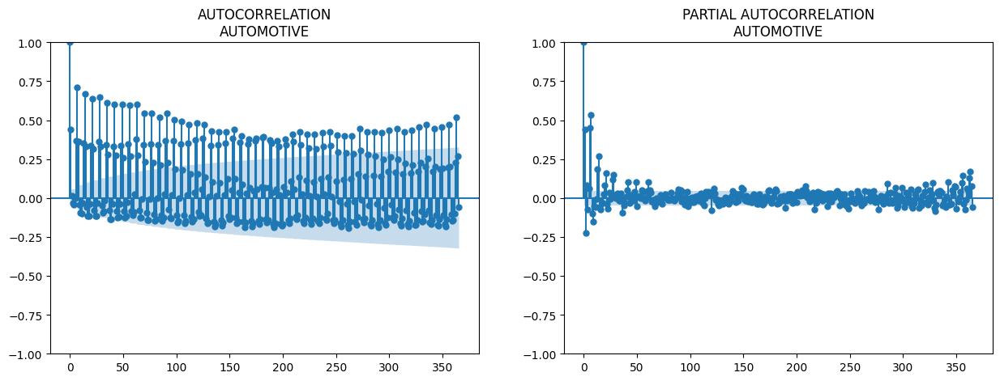

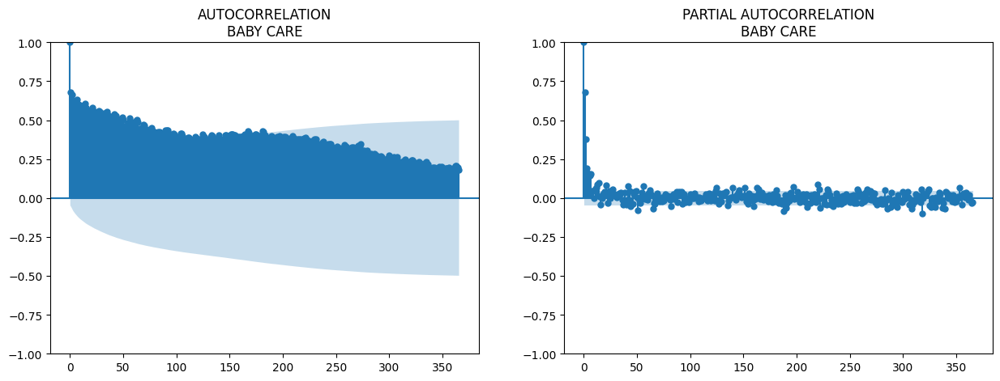

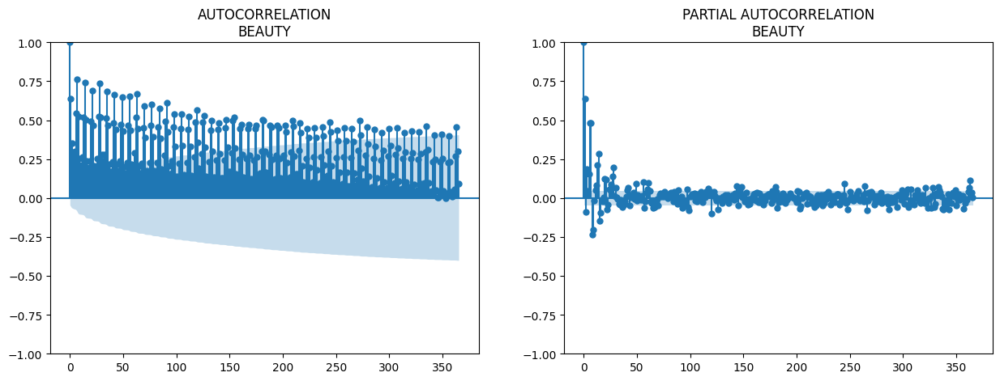

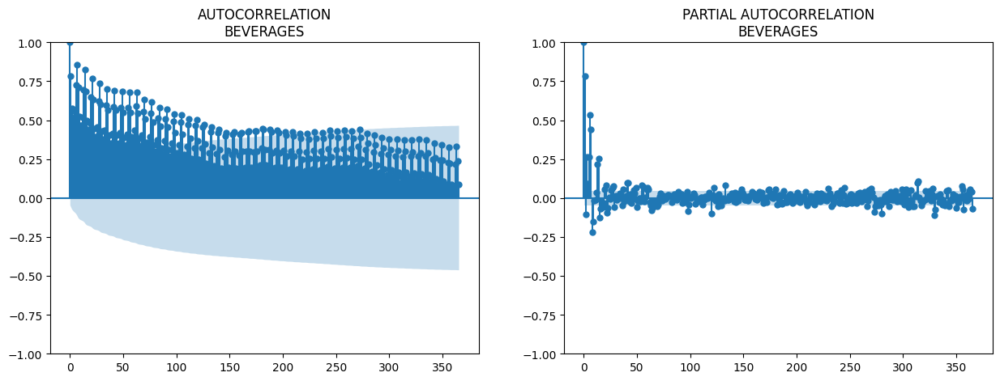

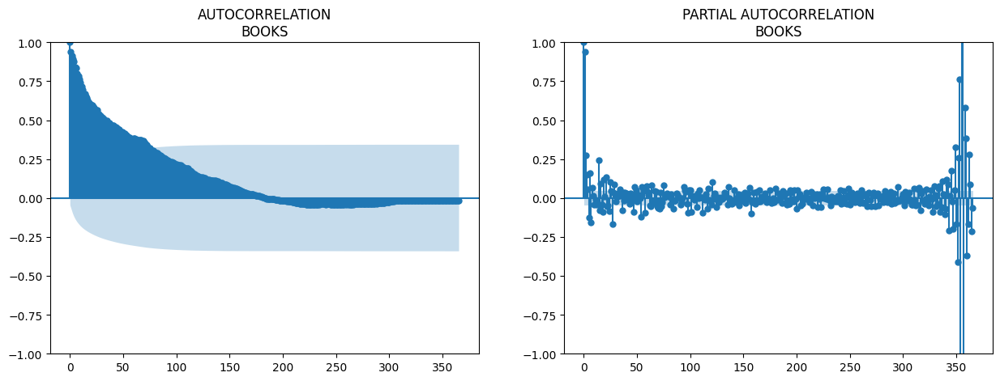

...

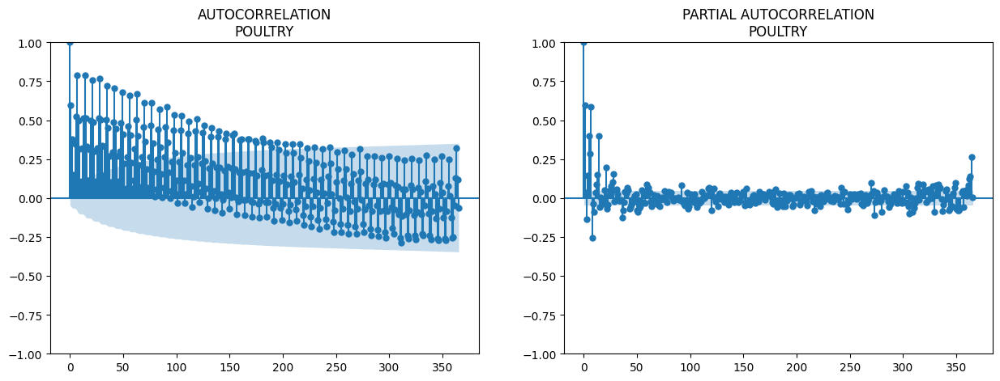

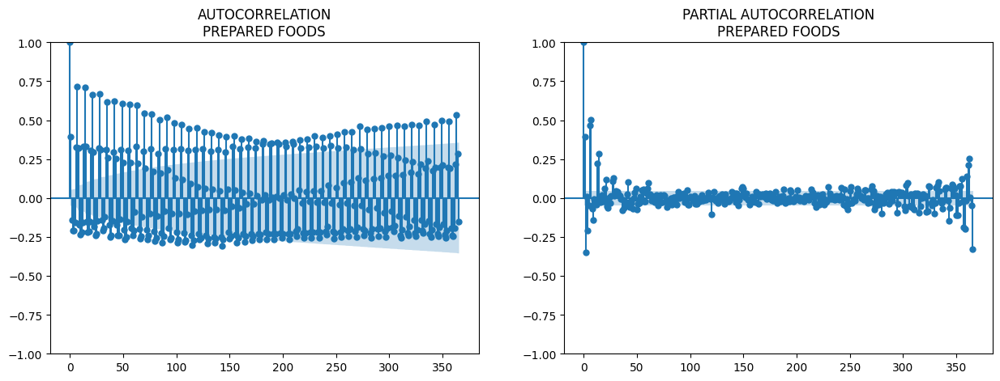

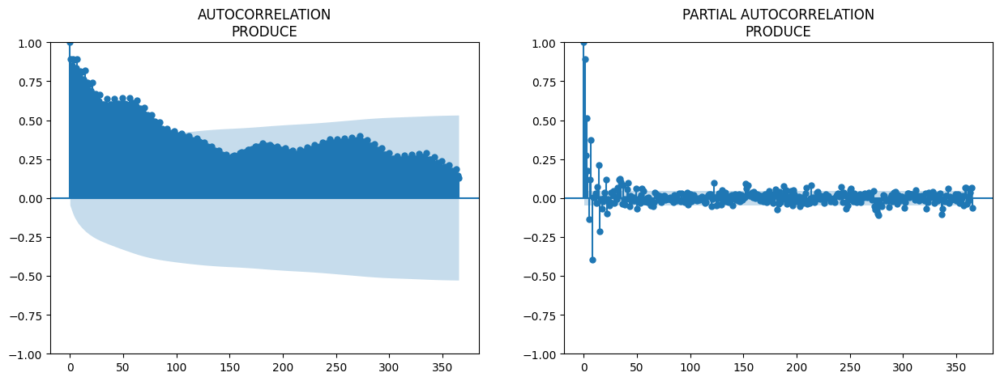

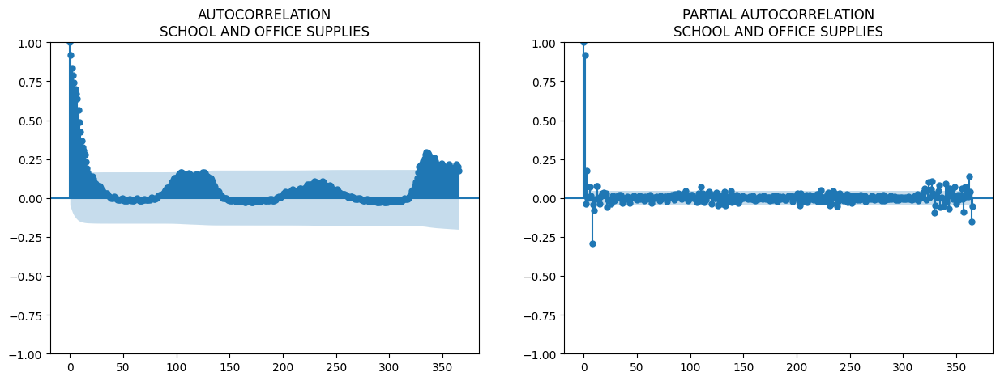

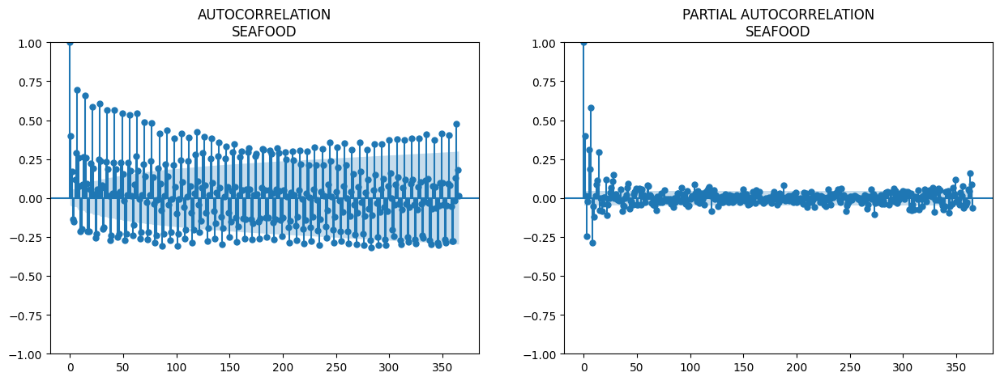

In [1029]:
a = d[(d.sales.notnull())].groupby(["date", "family"]).sales.mean().reset_index().set_index("date")
for num, i in enumerate(a.family.unique()):
    try:
        fig, ax = plt.subplots(1, 2, figsize = (15, 5))
        temp = a[(a.family == i)]
        sm.graphics.tsa.plot_acf(temp.sales, lags = 365, ax = ax[0], title = "AUTOCORRELATION\n" + i)
        sm.graphics.tsa.plot_pacf(temp.sales, lags = 365, ax = ax[1], title = "PARTIAL AUTOCORRELATION\n" + i)
    except:
        pass

In [1030]:
a = d[d.year.isin([2016, 2017])].groupby(["year", "day_of_year"]).sales.mean().reset_index()
px.line(a, x = "day_of_year", y = "sales", color = "year", title = "Average sales for 2016 and 2017")

### simple moving average

In [1031]:
a = train_data.sort_values(["store_nbr", "family", "date"])
for i in [20, 30, 45, 60, 90, 120, 365, 730]:
    a["SMA" + str(i) + "_sales_lag16"] = a.groupby(["store_nbr", "family"]).rolling(i).sales.mean().shift(16).values
    a["SMA" + str(i) + "_sales_lag30"] = a.groupby(["store_nbr", "family"]).rolling(i).sales.mean().shift(30).values
    a["SMA" + str(i) + "_sales_lag60"] = a.groupby(["store_nbr", "family"]).rolling(i).sales.mean().shift(60).values
print("Correlation")
a[["sales"] + a.columns[a.columns.str.startswith("SMA")].tolist()].corr()

Correlation


,sales,SMA20_sales_lag16,SMA20_sales_lag30,SMA20_sales_lag60,SMA30_sales_lag16,SMA30_sales_lag30,SMA30_sales_lag60,SMA45_sales_lag16,SMA45_sales_lag30,SMA45_sales_lag60,SMA60_sales_lag16,SMA60_sales_lag30,SMA60_sales_lag60,SMA90_sales_lag16,SMA90_sales_lag30,SMA90_sales_lag60,SMA120_sales_lag16,SMA120_sales_lag30,SMA120_sales_lag60,SMA365_sales_lag16,SMA365_sales_lag30,SMA365_sales_lag60,SMA730_sales_lag16,SMA730_sales_lag30,SMA730_sales_lag60
sales,1.00,0.91,0.89,0.87,0.91,0.89,0.87,0.91,0.90,0.87,0.91,0.89,0.87,0.91,0.89,0.87,0.90,0.89,0.86,0.90,0.89,0.87,0.91,0.89,0.86
SMA20_sales_lag16,0.91,1.00,0.99,0.95,1.00,0.98,0.95,0.99,0.98,0.95,0.99,0.98,0.95,0.99,0.98,0.95,0.98,0.97,0.95,0.97,0.97,0.95,0.98,0.98,0.95
SMA20_sales_lag30,0.89,0.99,1.00,0.96,0.99,1.00,0.96,1.00,0.99,0.97,0.99,0.99,0.97,0.99,0.99,0.96,0.99,0.98,0.96,0.97,0.97,0.96,0.98,0.98,0.96
SMA20_sales_lag60,0.87,0.95,0.96,1.00,0.96,0.98,1.00,0.98,0.99,0.99,0.99,0.99,0.99,0.99,0.99,0.99,0.99,0.99,0.98,0.98,0.97,0.97,0.98,0.98,0.98
SMA30_sales_lag16,0.91,1.00,0.99,0.96,1.00,0.99,0.96,1.00,0.99,0.96,0.99,0.99,0.96,0.99,0.98,0.96,0.99,0.98,0.96,0.98,0.97,0.96,0.98,0.98,0.96
SMA30_sales_lag30,0.89,0.98,1.00,0.98,0.99,1.00,0.98,1.00,1.00,0.98,1.00,0.99,0.98,0.99,0.99,0.97,0.99,0.99,0.97,0.98,0.98,0.97,0.98,0.98,0.98
SMA30_sales_lag60,0.87,0.95,0.96,1.00,0.96,0.98,1.00,0.98,0.99,1.00,0.99,0.99,0.99,0.99,0.99,0.99,0.99,0.99,0.99,0.98,0.98,0.98,0.98,0.98,0.98
SMA45_sales_lag16,0.91,0.99,1.00,0.98,1.00,1.00,0.98,1.00,1.00,0.98,1.00,0.99,0.98,0.99,0.99,0.98,0.99,0.99,0.97,0.98,0.98,0.97,0.98,0.98,0.98
SMA45_sales_lag30,0.90,0.98,0.99,0.99,0.99,1.00,0.99,1.00,1.00,0.99,1.00,1.00,0.99,1.00,0.99,0.98,0.99,0.99,0.98,0.98,0.98,0.98,0.98,0.98,0.98
SMA45_sales_lag60,0.87,0.95,0.97,0.99,0.96,0.98,1.00,0.98,0.99,1.00,0.99,0.99,1.00,0.99,1.00,0.99,0.99,0.99,0.99,0.98,0.98,0.98,0.98,0.98,0.98


In [1032]:
# b = a[(a.store_nbr == 1)].set_index("date")
# for i in b.family.unique():
#     fig, ax = plt.subplots(2, 4, figsize = (20, 10))
#     b[b.family == i][["sales", "SMA20_sales_lag16"]].plot(legend = True, ax = ax[0, 0], linewidth = 4)
#     b[b.family == i][["sales", "SMA30_sales_lag16"]].plot(legend = True, ax = ax[0, 1], linewidth = 4)
#     b[b.family == i][["sales", "SMA45_sales_lag16"]].plot(legend = True, ax = ax[0, 2], linewidth = 4)
#     b[b.family == i][["sales", "SMA60_sales_lag16"]].plot(legend = True, ax = ax[0, 3], linewidth = 4)
#     b[b.family == i][["sales", "SMA90_sales_lag16"]].plot(legend = True, ax = ax[1, 0], linewidth = 4)
#     b[b.family == i][["sales", "SMA120_sales_lag16"]].plot(legend = True, ax = ax[1, 1], linewidth = 4)
#     b[b.family == i][["sales", "SMA365_sales_lag16"]].plot(legend = True, ax = ax[1, 2], linewidth = 4)
#     b[b.family == i][["sales", "SMA730_sales_lag16"]].plot(legend = True, ax = ax[1, 3], linewidth = 4)
#     plt.suptitle("STORE 1 - " + i, fontsize = 15)
#     plt.tight_layout(pad = 1.5)
#     for j in range(0, 4):
#         ax[0, j].legend(fontsize = "x-large")
#         ax[1, j].legend(fontsize = "x-large")
#     plt.show()

### Exponential Moving Average

In [1033]:
def ewm_features(dataframe, alphas, lags):
    dataframe = dataframe.copy()
    for alpha in alphas:
        for lag in lags:
            dataframe['sales_ewm_alpha_' + str(alpha).replace(".", "") + "_lag_" + str(lag)] = \
                dataframe.groupby(["store_nbr", "family"])['sales']. \
                    transform(lambda x: x.shift(lag).ewm(alpha = alpha).mean())
    return dataframe

alphas = [0.95, 0.9, 0.8, 0.7, 0.5]
lags = [16, 30, 60, 90]

a = ewm_features(a, alphas, lags)

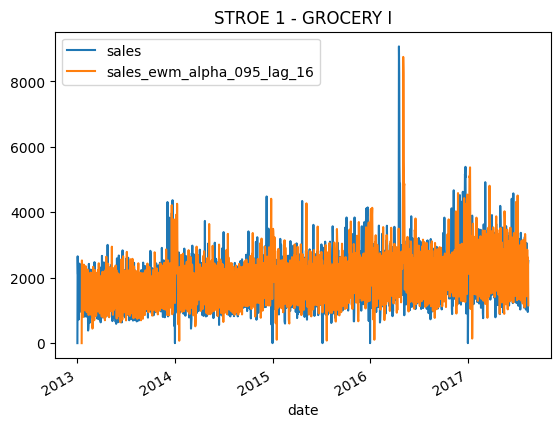

In [1034]:
a[(a.store_nbr == 1) & (a.family == "GROCERY I")].set_index("date")[["sales", "sales_ewm_alpha_095_lag_16"]].plot(title = "STROE 1 - GROCERY I");

###### * 아래 링크를 참고 했으며, 개인적인 공부를 위한 코드입니다.<br>참고) https://www.kaggle.com/code/ekrembayar/store-sales-ts-forecasting-a-comprehensive-guide